In [1]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import math
import numpy as np
import scipy.stats as stats
from cleaning_data.EDA_utils import *

In [2]:
data = pd.read_csv("FICO_Dataset.csv", sep = ";")
target_y = "RiskPerformance"
inputs = list(set(data.columns) - set([target_y]))
color_palette = {1: "red", 0: "blue"}
data.describe()

,RiskPerformance,ExternalRiskEstimate,NetFractionRevolvingBurden,AverageMInFile,MSinceOldestTradeOpen,PercentTradesWBalance,PercentInstallTrades,NumSatisfactoryTrades,NumTotalTrades,PercentTradesNeverDelq,MSinceMostRecentInqexcl7days
count,5245.000000,7442.000000,7442.000000,7442.000000,7415.000000,7386.000000,7442.000000,7425.000000,7419.000000,7442.000000,7442.000000
mean,0.510391,71.326525,34.593926,77.422736,201.894673,65.196994,33.838753,21.640673,23.357191,91.835125,2.257861
std,0.499940,11.719087,28.942289,33.215290,99.467788,22.518968,17.109726,11.529218,12.817841,14.011211,4.899668
min,0.000000,-9.000000,-9.000000,-9.000000,-9.000000,-9.000000,-9.000000,-9.000000,-9.000000,-9.000000,-9.000000
25%,0.000000,64.000000,9.000000,57.000000,135.500000,50.000000,21.000000,13.000000,14.000000,89.000000,0.000000
50%,1.000000,72.000000,29.000000,75.000000,186.000000,67.000000,33.000000,20.000000,22.000000,97.000000,0.000000
75%,1.000000,80.000000,56.000000,95.000000,262.000000,82.000000,45.000000,28.000000,30.000000,100.000000,3.000000
max,1.000000,94.000000,232.000000,322.000000,803.000000,100.000000,100.000000,78.000000,100.000000,100.000000,24.000000


In [3]:
# data.loc[data["NumSatisfactoryTrades"] > data["NumTotalTrades"], "NumTotalTrades"] = np.nan
# data["PercentSatisfactoryTrades"] = (data["NumSatisfactoryTrades"] / data["NumTotalTrades"] * 100)#.clip(0, 100)
# inputs = list(set(data.columns) - set([target_y]))
# data["PercentSatisfactoryTrades"]

In [4]:
data[data['NumSatisfactoryTrades'] > data['NumTotalTrades']].dropna()

,RiskPerformance,ExternalRiskEstimate,NetFractionRevolvingBurden,AverageMInFile,MSinceOldestTradeOpen,PercentTradesWBalance,PercentInstallTrades,NumSatisfactoryTrades,NumTotalTrades,PercentTradesNeverDelq,MSinceMostRecentInqexcl7days
2286,1.0,66,15,84,367.0,31.0,32,31.0,20.0,97,6
2288,0.0,74,1,146,305.0,31.0,17,17.0,8.0,94,10
2289,0.0,81,4,39,17.0,67.0,15,12.0,2.0,100,14
2290,0.0,89,2,141,378.0,23.0,24,21.0,10.0,100,15
2292,1.0,69,25,101,180.0,45.0,29,30.0,9.0,100,16
...,...,...,...,...,...,...,...,...,...,...,...
2606,1.0,57,89,144,226.0,94.0,38,24.0,7.0,83,7
2611,1.0,60,57,87,91.0,50.0,20,23.0,3.0,76,2
2616,1.0,78,7,79,125.0,23.0,26,30.0,23.0,97,6
2617,1.0,58,78,61,196.0,83.0,22,23.0,16.0,96,0


In [5]:
def casos(n):
    print(f"Columnas con {n} en ellas")
    for column in data.columns:
        length = len(data[data[column] == n])
        if length > 0:
            print(f"{column}: {length}")

for n in [-9,-8,-7]:
    casos(n)
    print()

Columnas con -9 en ellas
ExternalRiskEstimate: 50
NetFractionRevolvingBurden: 50
AverageMInFile: 50
MSinceOldestTradeOpen: 50
PercentTradesWBalance: 50
PercentInstallTrades: 50
NumSatisfactoryTrades: 50
NumTotalTrades: 50
PercentTradesNeverDelq: 50
MSinceMostRecentInqexcl7days: 50

Columnas con -8 en ellas
NetFractionRevolvingBurden: 11
MSinceOldestTradeOpen: 1
PercentTradesWBalance: 1
MSinceMostRecentInqexcl7days: 39

Columnas con -7 en ellas
MSinceMostRecentInqexcl7days: 50



# Drop na values

In [6]:
data[data == -9] = np.nan
data = data.dropna(subset=list(set(data.columns) - set([target_y])), how="all")

In [7]:
# from sklearn.impute import KNNImputer
# # data = impute_regression(data, "NumSatisfactoryTrades","NumTotalTrades")
# knn_imputer = KNNImputer(n_neighbors=20)
# data[inputs] = knn_imputer.fit_transform(data[inputs].values)
# data = data.dropna(subset = ["MSinceOldestTradeOpen","PercentTradesWBalance"])
# data = data.dropna(subset = ["MSinceOldestTradeOpen","PercentTradesWBalance","NumSatisfactoryTrades","NumTotalTrades"])

In [ ]:
data.to_csv("data/data_without_na.dat", sep = "\t", index = False)


# Handle special cases

In [ ]:
mode_imputation = ['MSinceMostRecentInqexcl7days','PercentTradesNeverDelq','PercentTradesWBalance','NetFractionRevolvingBurden']
mean_imputation = ['NumTotalTrades','NumSatisfactoryTrades','MSinceOldestTradeOpen', 'ExternalRiskEstimate','PercentInstallTrades', 'AverageMInFile']
mean_imputation = mode_imputation + mean_imputation
for column in data.columns:

    if column in mode_imputation:
        impute_value = data[column].mode()[0]
    if column in mean_imputation:
        impute_value = data[column].mean()

    if any(data[column] == -8):
        # new_col = column + "-8"
        # data[new_col] = 0
        # data.loc[data[column] == -8, new_col] = 1
        # data.loc[data[column] == -8, column] = impute_valpue
        data.loc[data[column] == -8, column] = np.nan

    if any(data[column] == -7):
        # new_col = column + "-7"
        # data[new_col] = 0
        # data.loc[data[column] == -7, new_col] = 1
        # data.loc[data[column] == -7, column] =  impute_value
        data.loc[data[column] == -7, column] = np.nan
    

In [ ]:
# knn_imputer = KNNImputer(n_neighbors=20)
# data[inputs] = knn_imputer.fit_transform(data[inputs].values)


In [ ]:
# my_imputer.params


In [9]:
print(data.isna().sum())
print("Percentage of NAN values")
print(data.isna().sum() / len(data) * 100)
print("Rotal rows:", len(data))

RiskPerformance                 2197
ExternalRiskEstimate               0
NetFractionRevolvingBurden         0
AverageMInFile                     0
MSinceOldestTradeOpen             27
PercentTradesWBalance             56
PercentInstallTrades               0
NumSatisfactoryTrades             17
NumTotalTrades                    23
PercentTradesNeverDelq             0
MSinceMostRecentInqexcl7days       0
dtype: int64
Percentage of NAN values
RiskPerformance                 29.721320
ExternalRiskEstimate             0.000000
NetFractionRevolvingBurden       0.000000
AverageMInFile                   0.000000
MSinceOldestTradeOpen            0.365260
PercentTradesWBalance            0.757576
PercentInstallTrades             0.000000
NumSatisfactoryTrades            0.229978
NumTotalTrades                   0.311147
PercentTradesNeverDelq           0.000000
MSinceMostRecentInqexcl7days     0.000000
dtype: float64
Rotal rows: 7392


In [10]:
data_without_na = data.copy()

# Look for interactions

In [11]:
def plot_residuals(data, output_column, prediction_column, categorical_var=None, title = None):
    """
    Plot residuals of a model against all variables in the DataFrame. Additionally, plot
    a histogram and a QQ-plot of the residuals.

    Args:
        data (pd.DataFrame): The DataFrame containing the data.
        output_column (str): The name of the output column.
        prediction_column (str): The name of the prediction column.
        categorical_var (str, optional): The name of a categorical variable for coloring. Defaults to None.
    """
    # TODO: As before, calculate residuals
    data['residuals'] = data[output_column] - data[prediction_column] 

    # Identify columns to plot (excluding the output and prediction columns)
    columns_to_plot = [col for col in data.columns if col not in [output_column, prediction_column, 'residuals']]

    # Number of rows and columns for the subplot
    n_cols = 3
    n_rows = int(len(columns_to_plot) / n_cols) + 2  # Additional row for histogram and QQ-plot

    # Create subplots
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols * 5, n_rows * 5))

    # Flatten the axes array for easy iteration
    axes = axes.flatten()

    # TODO: Plot each variable against the residuals
    for i, col in enumerate(columns_to_plot):
        ax = axes[i]
        
        if categorical_var and categorical_var in data.columns:
            sns.scatterplot(x = col, y = data["residuals"], data=data, ax=ax, hue = categorical_var)
        else:
            sns.scatterplot(x = col, y = data["residuals"], data=data, ax=ax)
        
        ax.set_title(f'Residuals vs {col}')
        ax.axhline(0, ls='--', color='r')

    # Histogram of residuals
    sns.histplot(data['residuals'], kde=True, ax=axes[i + 1])
    axes[i + 1].set_title('Histogram of Residuals')

    # QQ-plot of residuals
    stats.probplot(data['residuals'], dist="norm", plot=axes[i + 2])
    axes[i + 2].set_title('QQ-Plot of Residuals')

    # Hide any unused axes
    for j in range(i + 3, len(axes)):
        axes[j].set_visible(False)
    plt.title(title, {"size": 15})
    plt.tight_layout()
    plt.show()

# Perform the train-test split

In [12]:
supervised_data = data[~data[target_y].isna()]
supervised_shuffle = supervised_data.sample(frac = 1, random_state=42)
train_set_length = int(np.round(0.8 * len(supervised_shuffle)))
print(f"The training dataset will have {train_set_length}")
supervised_train, supervised_test = supervised_shuffle.iloc[:train_set_length], supervised_shuffle.iloc[train_set_length:]

The training dataset will have 4156


In [13]:
supervised_data_for_no_box_cox = data_without_na[~data_without_na[target_y].isna()]
supervised_shuffle_for_no_box_cox = supervised_data_for_no_box_cox.sample(frac = 1, random_state=0)
train_set_length = int(np.round(0.8 * len(supervised_shuffle_for_no_box_cox)))
print(f"The training dataset will have {train_set_length}")
supervised_train_no_box_cox, supervised_test_no_box_cox = supervised_shuffle_for_no_box_cox.iloc[:train_set_length], supervised_shuffle_for_no_box_cox.iloc[train_set_length:]

The training dataset will have 4156


# Draw qq-plots

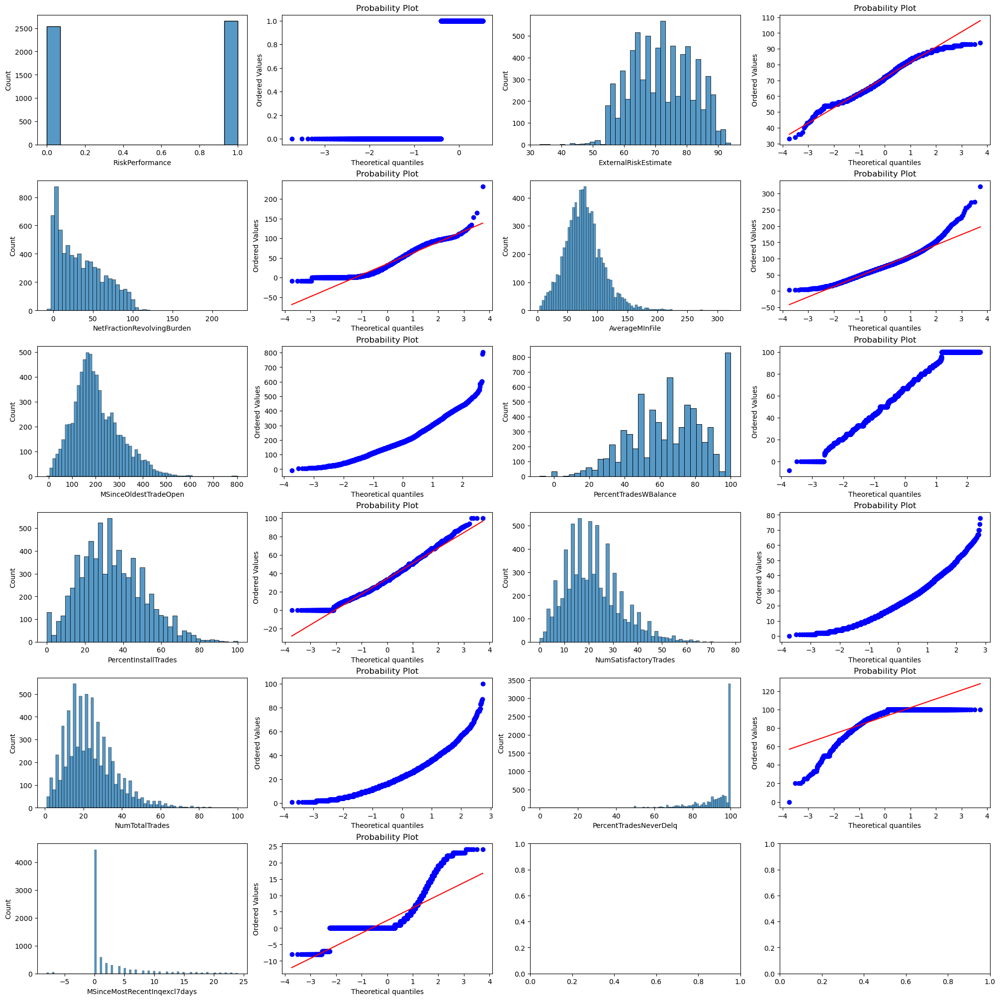

In [14]:
# data["hue_for"] = data['MSinceMostRecentInqexcl7days'] > 0
plot_qq_plot(data)#, hue = "hue_for", color_palette = color_palette)

# Standarize and scale datasets

In [15]:
from sklearn.impute import KNNImputer
imp = KNNImputer(n_neighbors=20)
supervised_train.loc[:, inputs] = imp.fit_transform(supervised_train[inputs].values, supervised_train[target_y].values)
supervised_test.loc[:, inputs] = imp.transform(supervised_test[inputs].values)

In [16]:
print(supervised_train.isna().sum())
print("Percentage of NAN values")
print(supervised_train.isna().sum() / len(supervised_train) * 100)
print("Rotal rows:", len(supervised_train))

RiskPerformance                 0
ExternalRiskEstimate            0
NetFractionRevolvingBurden      0
AverageMInFile                  0
MSinceOldestTradeOpen           0
PercentTradesWBalance           0
PercentInstallTrades            0
NumSatisfactoryTrades           0
NumTotalTrades                  0
PercentTradesNeverDelq          0
MSinceMostRecentInqexcl7days    0
dtype: int64
Percentage of NAN values
RiskPerformance                 0.0
ExternalRiskEstimate            0.0
NetFractionRevolvingBurden      0.0
AverageMInFile                  0.0
MSinceOldestTradeOpen           0.0
PercentTradesWBalance           0.0
PercentInstallTrades            0.0
NumSatisfactoryTrades           0.0
NumTotalTrades                  0.0
PercentTradesNeverDelq          0.0
MSinceMostRecentInqexcl7days    0.0
dtype: float64
Rotal rows: 4156


In [47]:
from sklearn.preprocessing import power_transform
# Box-cox transform
# cols = ['NumSatisfactoryTrades', 'NumTotalTrades','PercentInstallTrades', 'AverageMInFile','ExternalRiskEstimate','MSinceOldestTradeOpen','NetFractionRevolvingBurden']#, 'PercentSatisfactoryTrades']
cols = ['NetFractionRevolvingBurden', 'AverageMInFile', 'MSinceOldestTradeOpen',
        'PercentInstallTrades', 'NumSatisfactoryTrades', 'NumTotalTrades']
# train_transformed, lambdas = box_cox(supervised_train, cols)
# test_transformed, _ = box_cox(supervised_test, cols, lambdas)
train_transformed = supervised_train.copy()
test_transformed = supervised_test.copy()

train_transformed[cols] = power_transform(train_transformed[cols].values)


# Standarize
# standarize_cols = ['ExternalRiskEstimate', 'NetFractionRevolvingBurden','AverageMInFile', 'NumSatisfactoryTrades', 'NumTotalTrades','MSinceOldestTradeOpen']
# scale_cols = ['PercentInstallTrades', 'PercentTradesWBalance', 'PercentTradesNeverDelq','MSinceMostRecentInqexcl7days']

# standarize_cols = standarize_cols + scale_cols
standarize_cols = inputs
standarize_cols = ['ExternalRiskEstimate', 'NetFractionRevolvingBurden',
                   'AverageMInFile', 'MSinceOldestTradeOpen', 'PercentTradesWBalance',
                   'PercentInstallTrades', 'NumSatisfactoryTrades', 'NumTotalTrades',
                   'PercentTradesNeverDelq', 'MSinceMostRecentInqexcl7days']
train_transformed, value_params = standarize(train_transformed, standarize_cols)
test_transformed, _ = standarize(test_transformed, standarize_cols, value_params)

# Scale
# values = {"MSinceMostRecentInqexcl7days": {"range": data['MSinceMostRecentInqexcl7days'].max()}}
# scale_cols = ["PercentSatisfactoryTrades"]# scale_cols #+ standarize_cols
# train_transformed, values = scale(train_transformed, scale_cols, values=None)
# test_transformed, _ = scale(test_transformed, scale_cols, values)

# Quantile Transform
from sklearn.preprocessing import QuantileTransformer
quantile_cols = ['NetFractionRevolvingBurden', 'PercentTradesWBalance', 'PercentTradesNeverDelq','MSinceMostRecentInqexcl7days']


# for column_quantile in quantile_cols:
#     quantile_transformer = QuantileTransformer(output_distribution="normal")
#     mode = train_transformed[column_quantile].mode()[0]
#     train_transformed.loc[train_transformed[column_quantile]!=mode, column_quantile] = quantile_transformer.fit_transform(train_transformed.loc[train_transformed[column_quantile]!=mode, [column_quantile]].values)
#     test_transformed.loc[test_transformed[column_quantile]!=mode, column_quantile] = quantile_transformer.transform(test_transformed.loc[test_transformed[column_quantile]!=mode, [column_quantile]].values)
#     train_transformed.loc[train_transformed[column_quantile]==mode, column_quantile] = 0
#     test_transformed.loc[test_transformed[column_quantile]==mode, column_quantile] = 0


In [48]:
# train_transformed["PercentSatisfactoryTrades"].describe()


# KNN IMPUTE

In [49]:
# from models.Models import KNNImputer
import pickle
# my_imputer = KNNImputer()

# new_train = my_imputer.fit_transform(train_transformed, inputs)
# with open("knn_imputer_params.obj", "wb") as fh:
#     pickle.dump(my_imputer.params, fh)
with open("knn_imputer_params.obj", "rb") as fh:
    params = pickle.load(fh)
print([column["k"] for column in params.values()])
print(np.mean([column["k"] for column in params.values()]))

[50, 100, 10, 10, 10, 50, 10, 5, 20, 20]
28.5


In [50]:
# new_train = my_imputer.transform(train_transformed, inputs)
# new_test = my_imputer.transform(test_transformed, inputs)
from sklearn.impute import KNNImputer
imp = KNNImputer(n_neighbors=20)
train_transformed.loc[:, inputs] = imp.fit_transform(train_transformed[inputs].values, train_transformed[target_y].values)
test_transformed.loc[:, inputs] = imp.transform(test_transformed[inputs].values)

In [51]:
# [params["k"] for params in my_imputer.params.values()]
# print(new_train.isna().sum())
# print("Percentage of NAN values")
# print(new_train.isna().sum() / len(new_train) * 100)
# print("Rotal rows:", len(new_train))


In [52]:
def plot_before_after(before, after, columns, hue1 =None,  hue2=None, color_palette=None):
    figure, axes = plt.subplots(
        len(columns), 2, figsize=(15, 10), constrained_layout=True
    )

    for ax, column in zip(axes, columns):
        sns.histplot(
            before,
            x=column,
            ax=ax[0],
            hue=hue1,
            palette=color_palette if hue1 is not None else None,
        )
        sns.histplot(
            after,
            x=column,
            ax=ax[1],
            hue=hue2,
            palette=color_palette if hue2 is not None else None,
        )
    plt.show()

In [53]:
# train_transformed["NetFractionRevolvingBurden0"] = (supervised_train["NetFractionRevolvingBurden"] == 0) * 1
# train_transformed["PercentTradesWBalance100"] = (supervised_train["PercentTradesWBalance"] == 100) * 1
# train_transformed["PercentTradesNeverDelq100"] = (supervised_train["PercentTradesNeverDelq"] == 100) * 1
# train_transformed["MSinceMostRecentInqexcl7days0"] = (supervised_train["MSinceMostRecentInqexcl7days"] == 0) * 1

# plot_before_after(supervised_train, train_transformed, quantile_cols, hue2 = 'MSinceMostRecentInqexcl7days0')

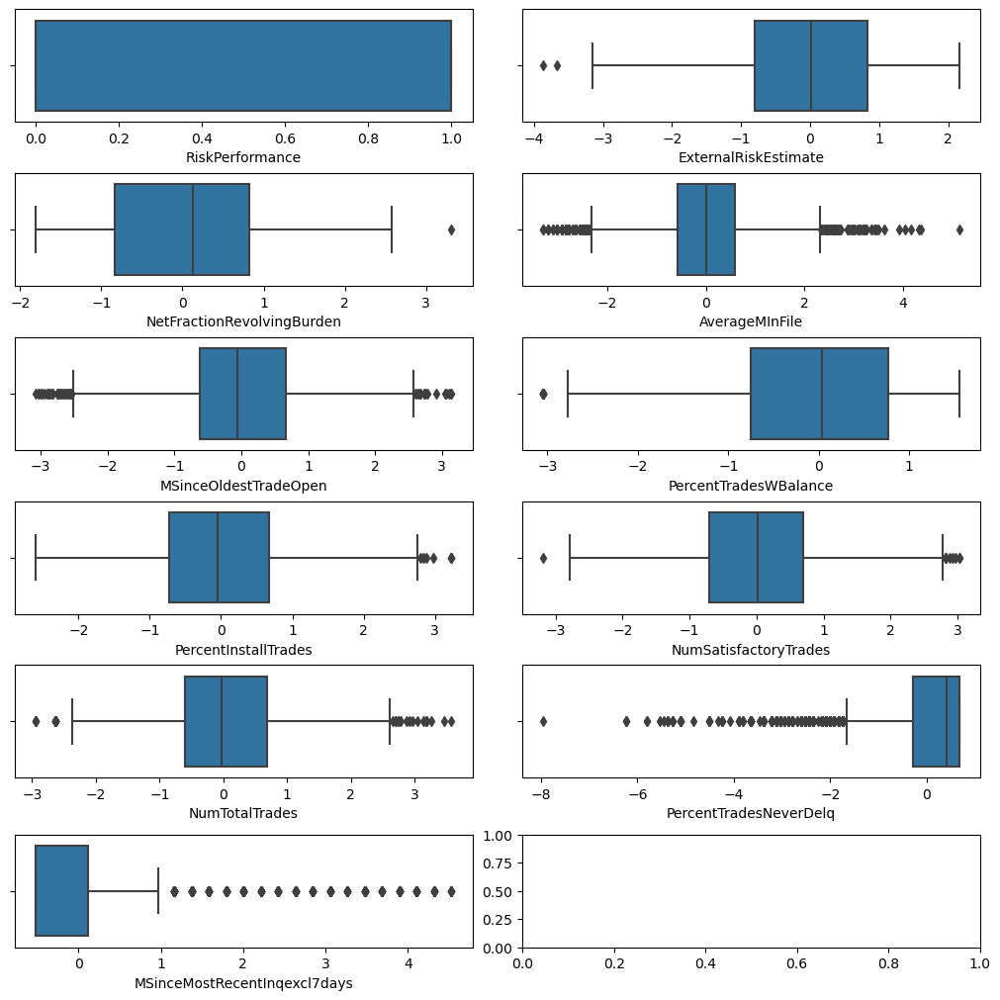

In [54]:
def plot_boxplot(df):
    figure, axes = plt.subplots(math.ceil(len(df.columns)/2), 2, figsize = (10,10), constrained_layout=True)
    axes = np.reshape(axes, (-1))
    for ax, column in zip(axes, df.columns):
        sns.boxplot(df, x = column, ax = ax)

plot_boxplot(train_transformed)

In [55]:
# lambdas

In [56]:
train_transformed["MSinceOldestTradeOpen"]

5744    1.723009
79      0.283304
6981    1.301014
6641   -0.073368
6492    1.625883
          ...   
5627    1.364282
3501   -0.389959
2433   -0.447224
7068    0.020114
4796   -1.787845
Name: MSinceOldestTradeOpen, Length: 4156, dtype: float64

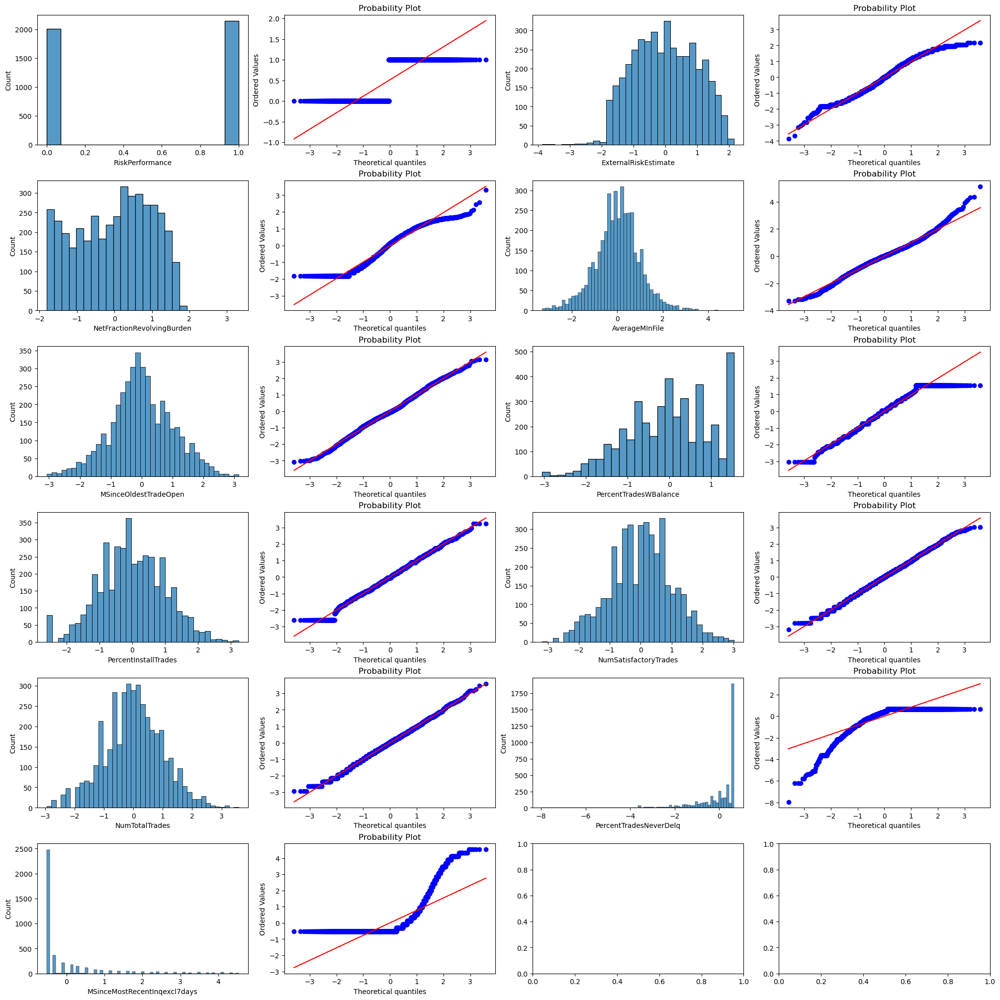

In [57]:
plot_qq_plot(train_transformed)

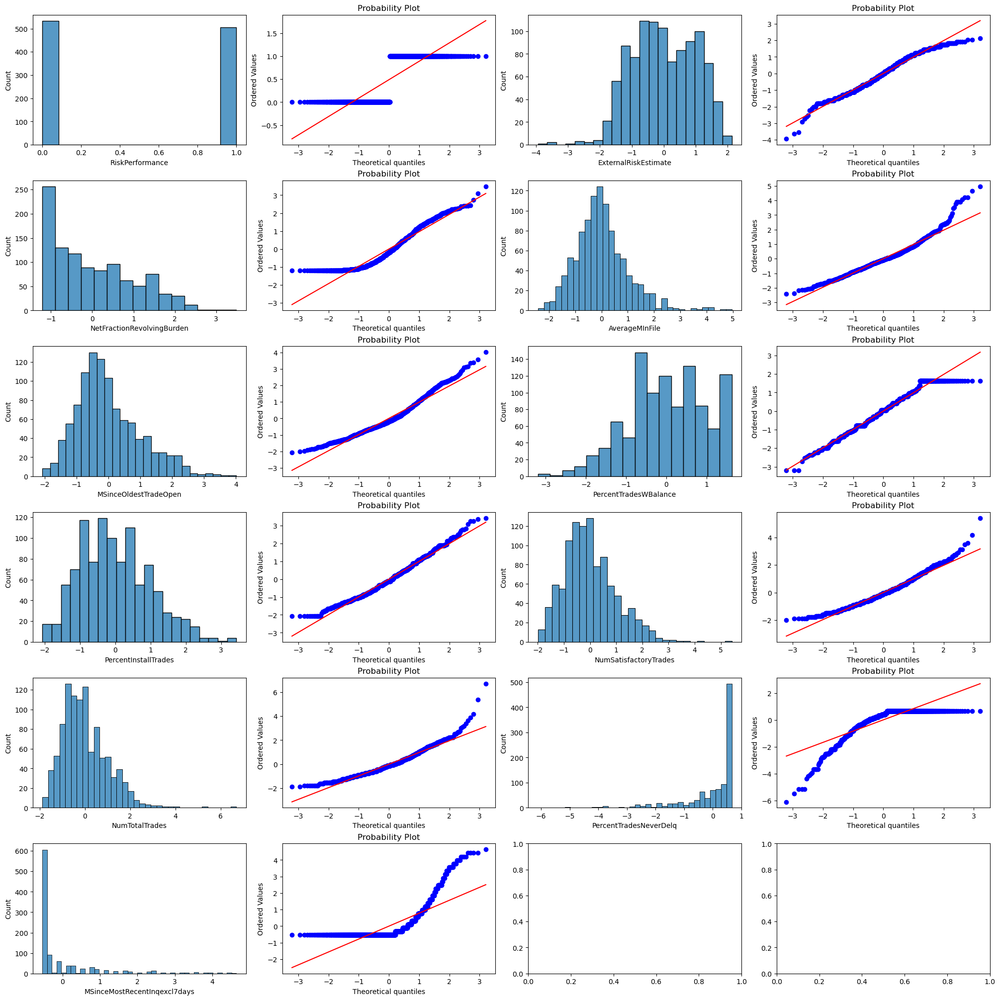

In [58]:
plot_qq_plot(test_transformed)

RiskPerformance


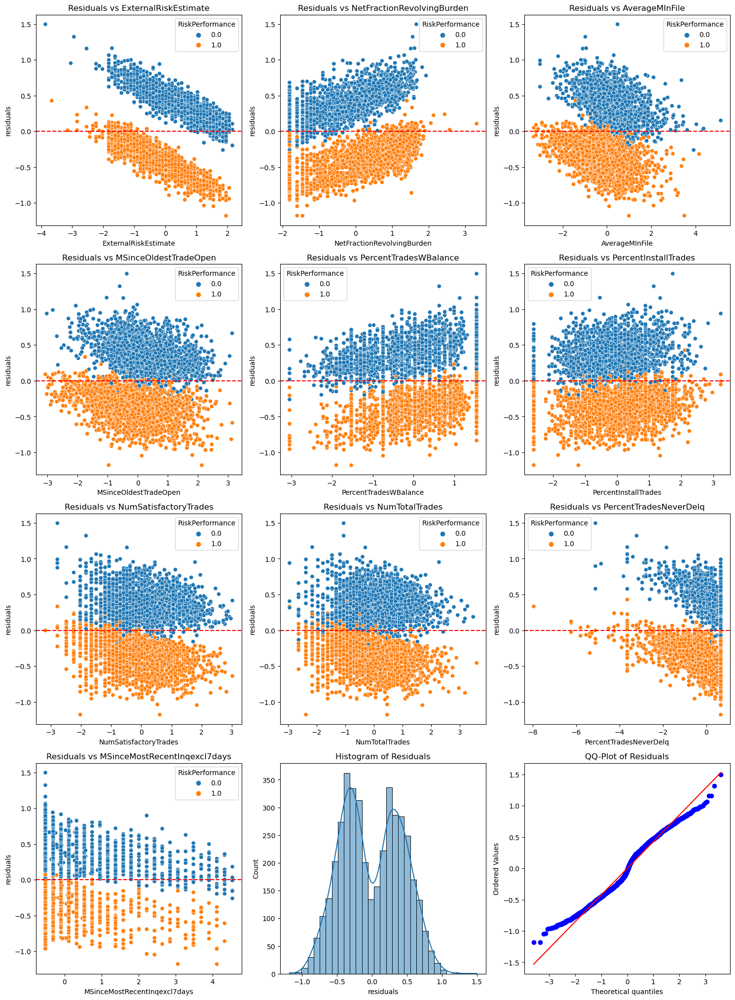

ExternalRiskEstimate


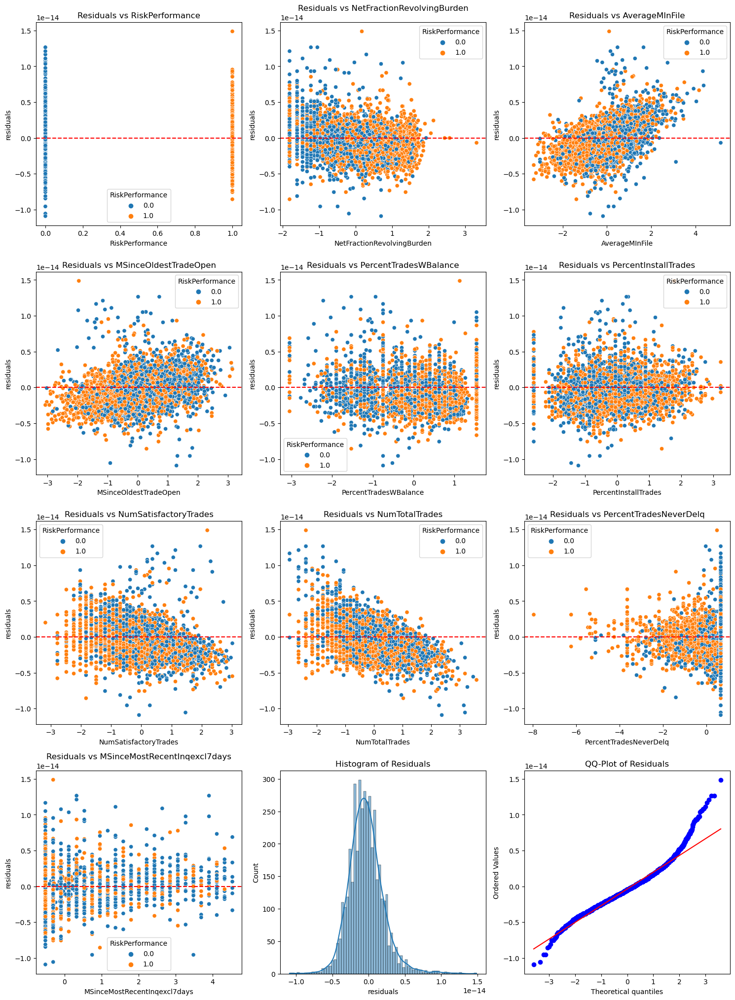

NetFractionRevolvingBurden


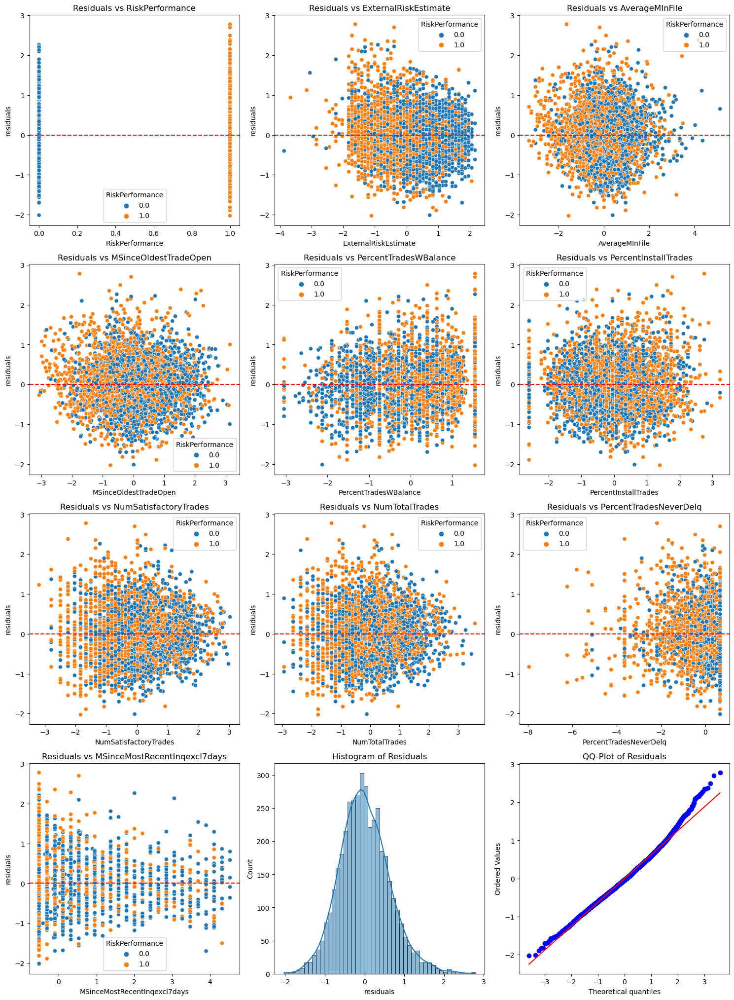

AverageMInFile


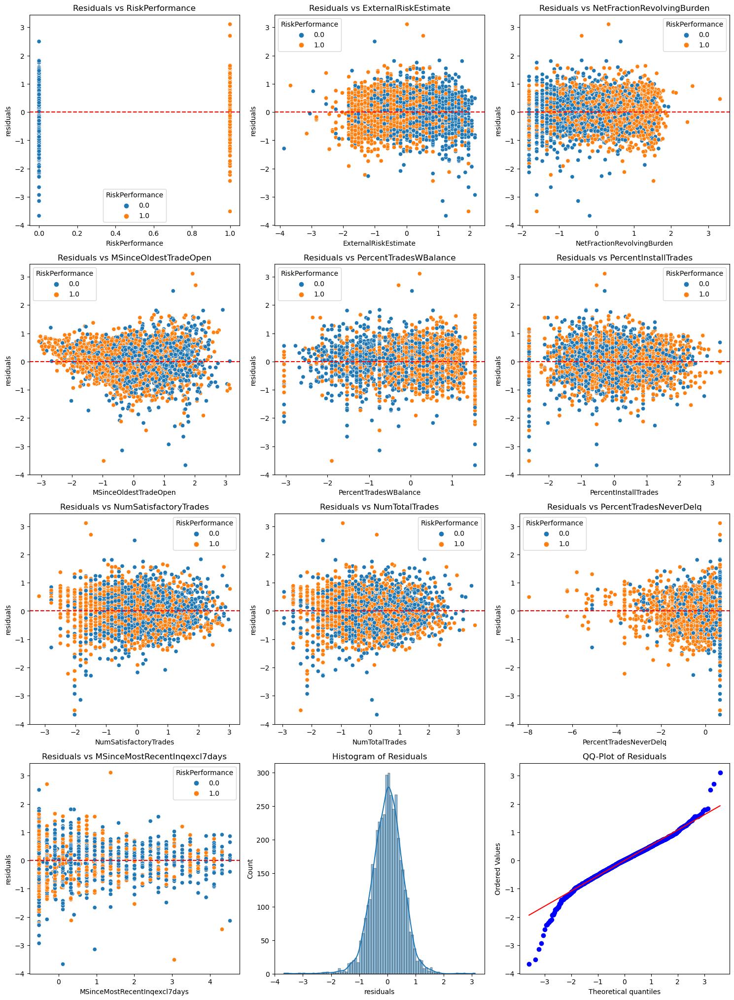

MSinceOldestTradeOpen


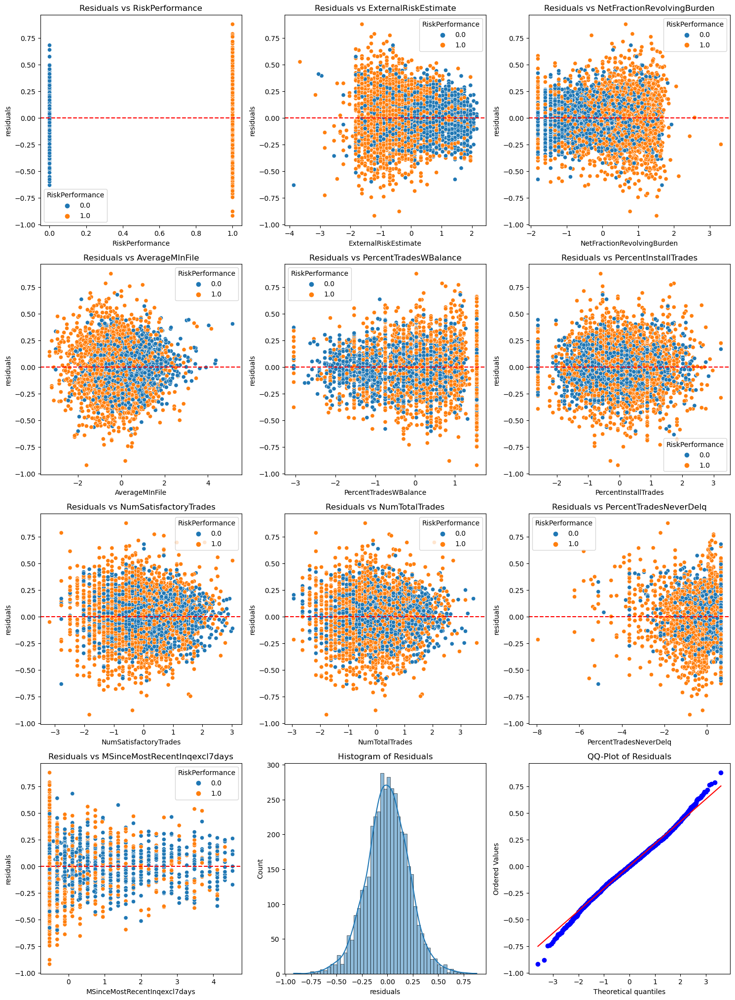

PercentTradesWBalance


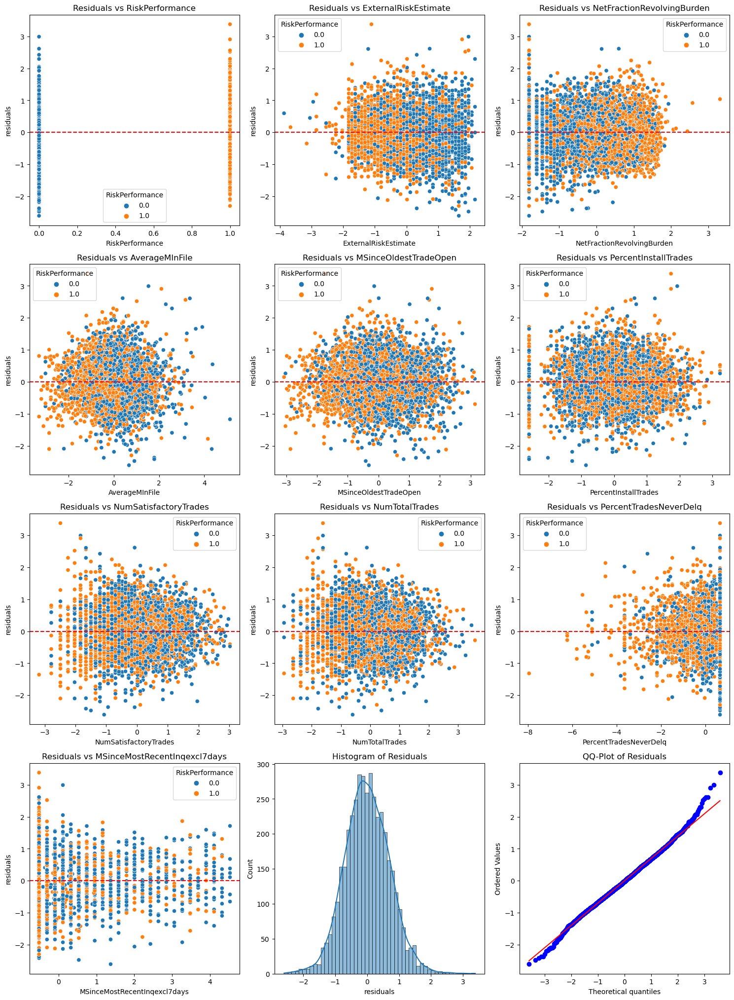

PercentInstallTrades


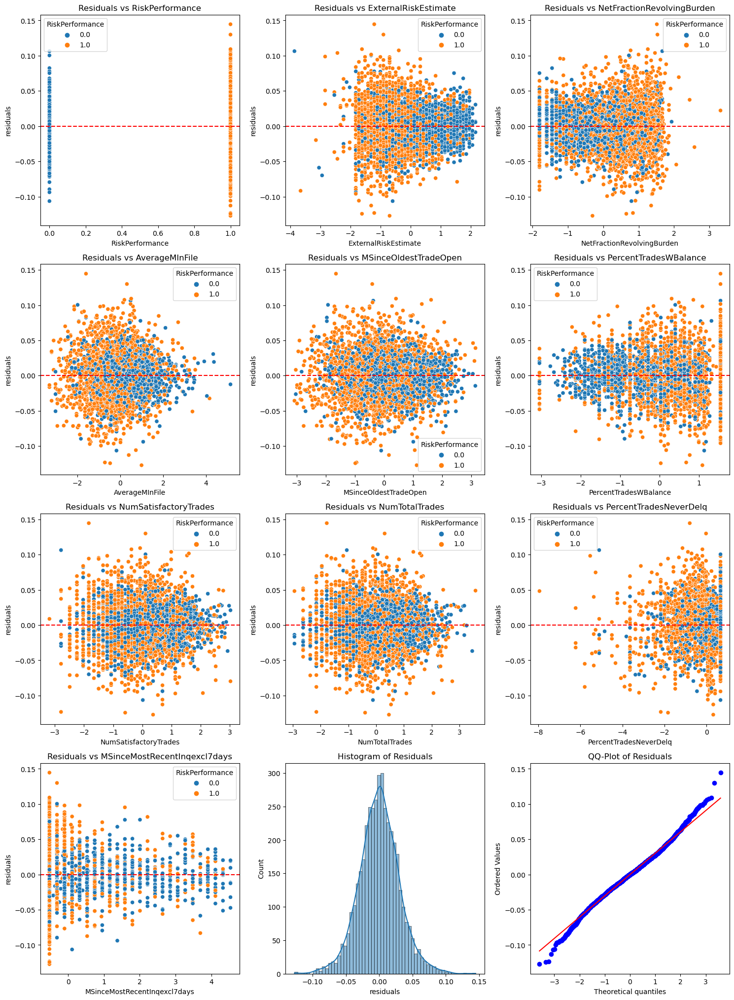

NumSatisfactoryTrades


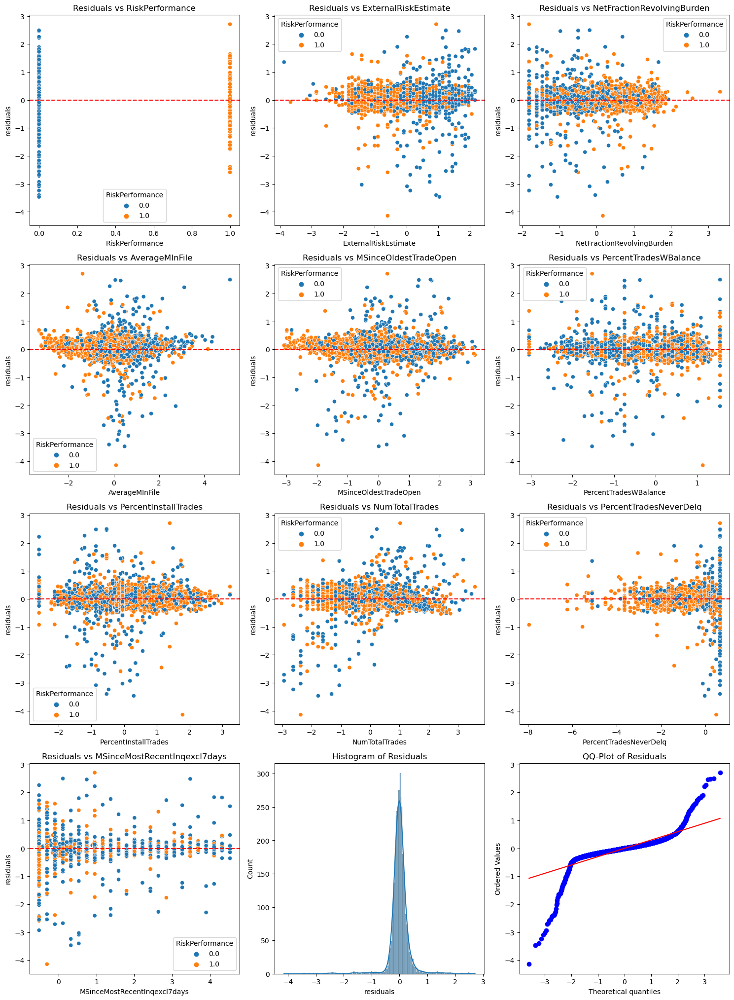

NumTotalTrades


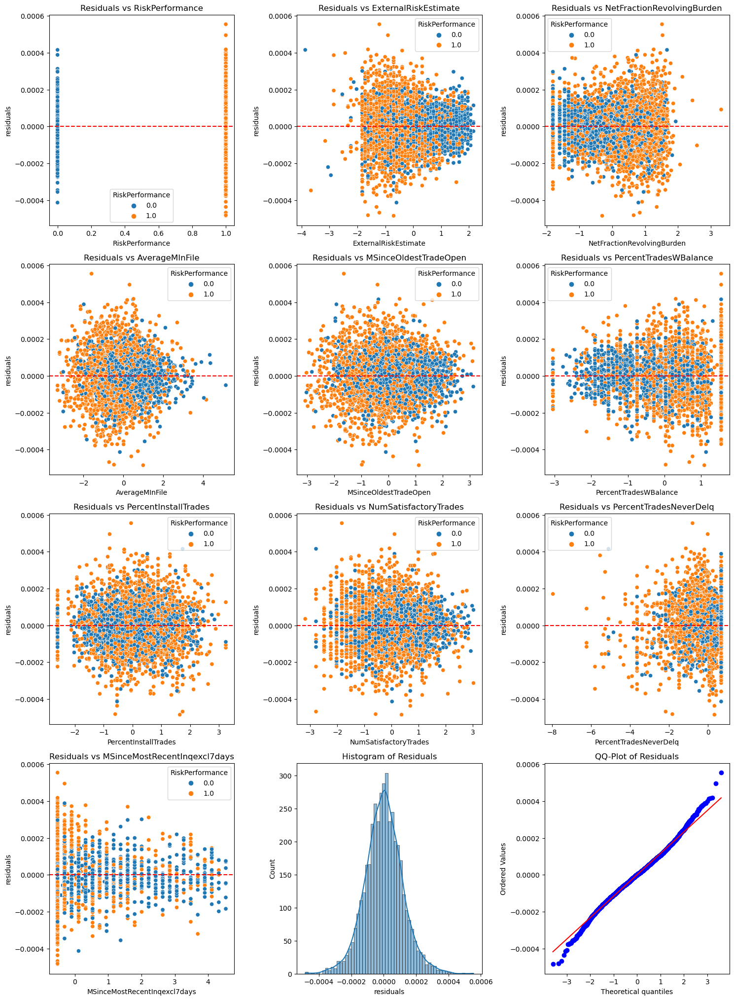

PercentTradesNeverDelq


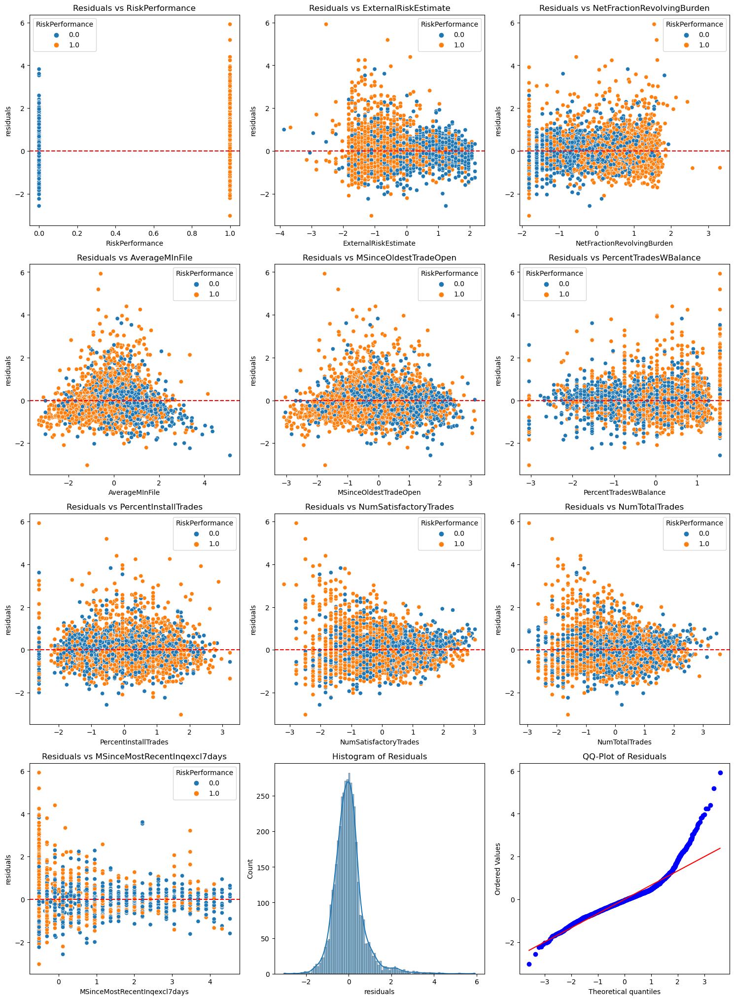

MSinceMostRecentInqexcl7days


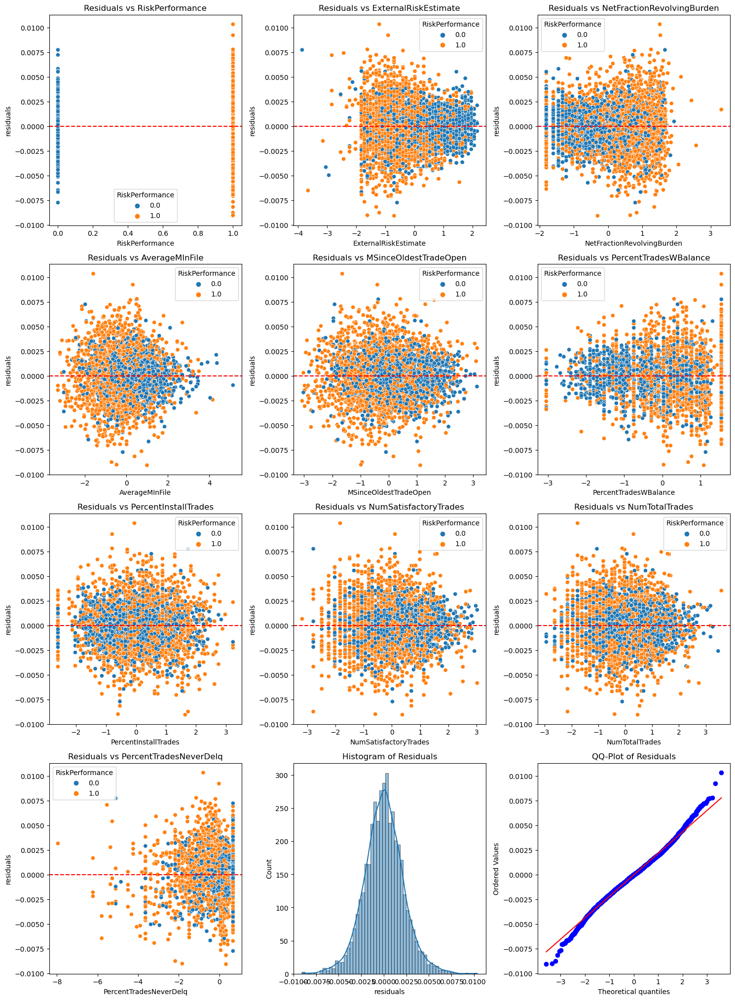

In [59]:
from sklearn.linear_model import LinearRegression
data_without_na = train_transformed.copy()
# changeable_columns = list(set(data_without_na.columns) - set([target_y]))
# for i, column_i in enumerate(changeable_columns):
#     data_without_na[column_i + "**2"] = data_without_na[column_i] ** 2
#     for column_j in changeable_columns[i+1:]:
#         data_without_na[column_i + " * "+ column_j] = data_without_na[column_i] * data_without_na[column_j]
for column in data_without_na.columns:
    # target_interactions = "MSinceOldestTradeOpen"
    target_interactions = column
    print(column)
    inputs_interactions = list(set(data_without_na.columns) - set([target_interactions]))
    data_without_na['NetFractionRevolvingBurden'] = data_without_na['NetFractionRevolvingBurden']
    X_interactions = data_without_na[inputs_interactions].values
    y_interactions = data_without_na[target_interactions].values
    linear_regression_interactions = LinearRegression().fit(X_interactions, y_interactions)
    data_without_na['predictions'] = linear_regression_interactions.predict(X_interactions)
    plot_residuals(data_without_na, 'predictions', target_interactions, target_y, f"Residuals of predicting {column}")


In [34]:
def get_correlated_pairs(df, threshold = 0.5):
    columns = df.columns
    corr = df.corr()

    correlated = {}

    for i, column_i in enumerate(columns):
        for column_j in columns[i+1: ]:
            val = corr.loc[column_i, column_j]
            if abs(val) > threshold:
                correlated[(column_i, column_j)] = val
    return correlated

In [35]:
correlated_pairs = get_correlated_pairs(data, 0.55)
correlated_pairs

{('ExternalRiskEstimate', 'NetFractionRevolvingBurden'): -0.6167923513475825,
 ('NetFractionRevolvingBurden', 'PercentTradesWBalance'): 0.6055482658439842,
 ('AverageMInFile', 'MSinceOldestTradeOpen'): 0.7172167482267763,
 ('NumSatisfactoryTrades', 'NumTotalTrades'): 0.8738976744432483}

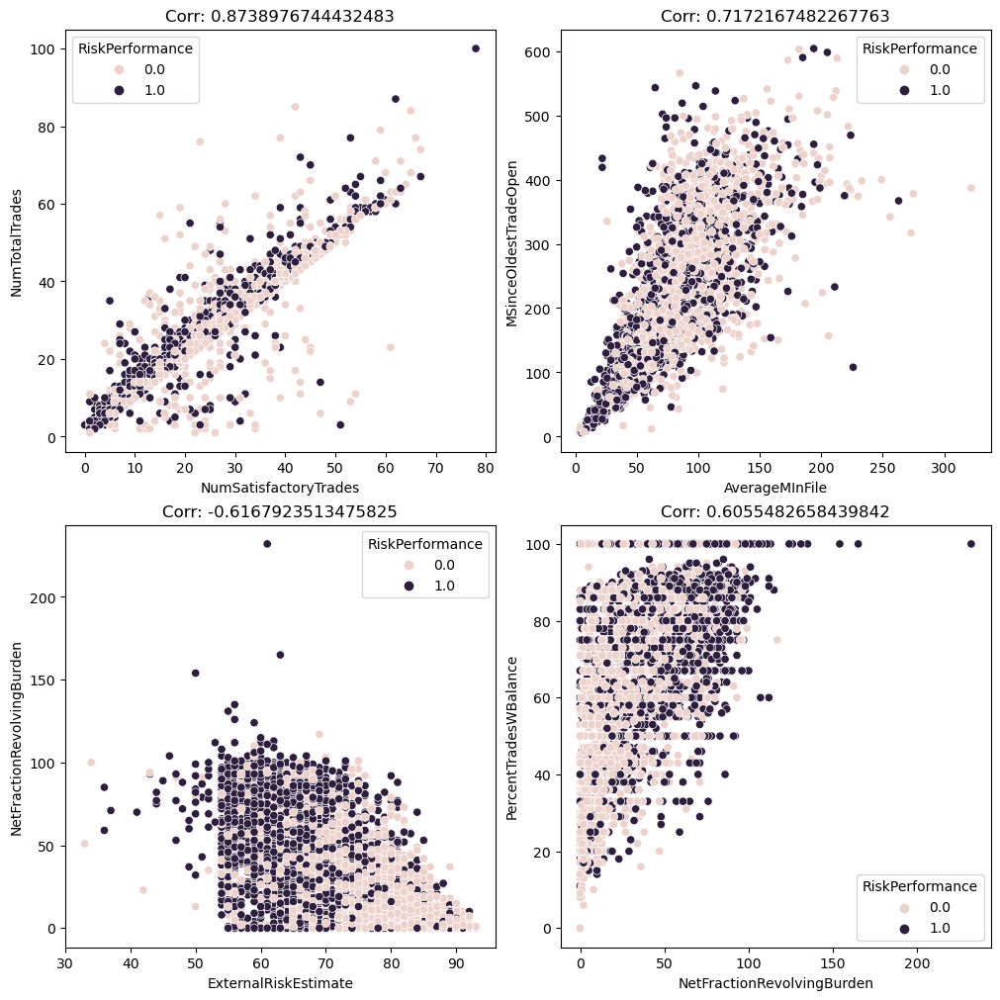

In [53]:
figure, axes = plt.subplots(math.ceil(len(correlated_pairs)/2), 2, figsize = (10,10), constrained_layout = True)

axes = np.reshape(axes, (-1))
for ax, pair in zip(axes, sorted(correlated_pairs, key = lambda x: -abs(correlated_pairs[x]))):
    x, y = pair
    sns.scatterplot(data, x = x, y = y, ax= ax, hue = target_y)
    ax.set_title(f"Corr: {correlated_pairs[pair]}")

<Axes: >

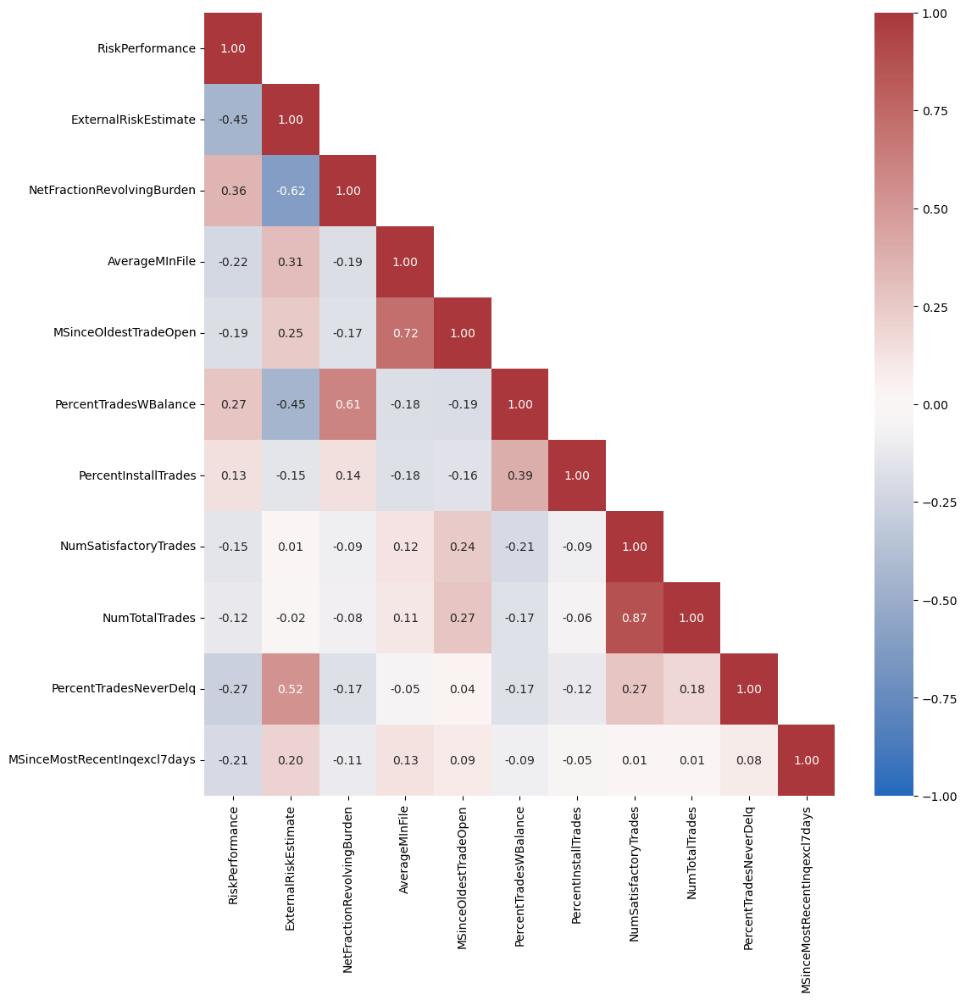

In [60]:
figure = plt.figure(figsize=(12,12))
corr = data.corr()
mask = np.triu(np.ones_like(corr, dtype=bool)) & ~np.diag(np.diag(np.ones_like(corr, dtype = bool)))
sns.heatmap(corr, mask = mask, annot = True, fmt=".2f", cmap="vlag", center = 0, vmax = 1, vmin = -1)

In [36]:
correlation_matrix = data.corr()
high_correlation_columns = correlation_matrix[(abs(correlation_matrix)> 0.5) & (abs(correlation_matrix) < 1)].dropna(axis = 1,how = "all").columns
print(f"Correlated variables: {', '.join(high_correlation_columns)}")
print(f"Uncorrelated variables: {', '.join(list(set(data.columns) - set(high_correlation_columns)))}")

Correlated variables: ExternalRiskEstimate, NetFractionRevolvingBurden, AverageMInFile, MSinceOldestTradeOpen, PercentTradesWBalance, NumSatisfactoryTrades, NumTotalTrades, PercentTradesNeverDelq
Uncorrelated variables: RiskPerformance, MSinceMostRecentInqexcl7days, PercentInstallTrades


c:\Users\jurko\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


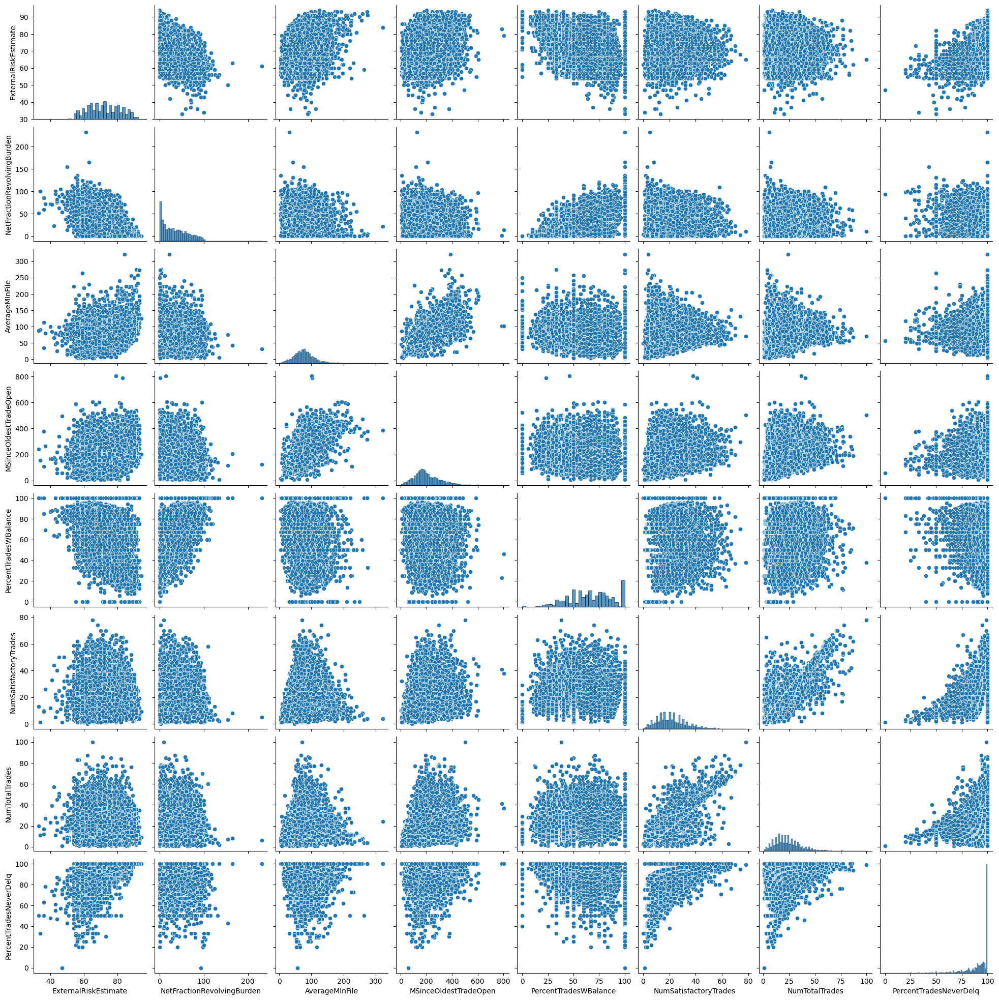

In [37]:
sns.pairplot(data[high_correlation_columns], diag_kind = "hist", kind = "scatter")

# Save train and test sets

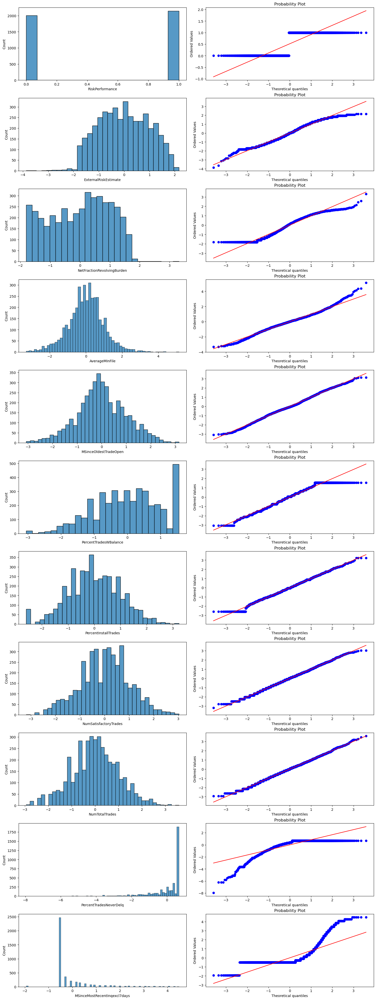

In [38]:
plot_qq_plot(train_transformed)

In [39]:
train_transformed.describe()

,RiskPerformance,ExternalRiskEstimate,NetFractionRevolvingBurden,AverageMInFile,MSinceOldestTradeOpen,PercentTradesWBalance,PercentInstallTrades,NumSatisfactoryTrades,NumTotalTrades,PercentTradesNeverDelq,MSinceMostRecentInqexcl7days
count,4156.000000,4.156000e+03,4.156000e+03,4.156000e+03,4.156000e+03,4.156000e+03,4.156000e+03,4.156000e+03,4.156000e+03,4.156000e+03,4.156000e+03
mean,0.516843,-7.009685e-16,-8.548397e-18,-2.479035e-17,-1.282260e-17,-5.411135e-16,-2.692745e-17,-1.282260e-17,-3.419359e-18,2.564519e-17,-2.393551e-17
std,0.499776,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00
min,0.000000,-3.865386e+00,-1.806404e+00,-3.303669e+00,-3.071296e+00,-3.045963e+00,-2.599248e+00,-3.183096e+00,-2.940765e+00,-7.950251e+00,-1.941300e+00
25%,0.000000,-8.022249e-01,-8.283410e-01,-5.769355e-01,-6.124374e-01,-7.478708e-01,-7.283280e-01,-7.006673e-01,-5.996203e-01,-2.800902e-01,-4.924171e-01
50%,1.000000,1.461807e-02,1.233050e-01,9.137395e-03,-5.242640e-02,3.348048e-02,-5.060765e-02,1.663710e-02,-2.662073e-02,4.093625e-01,-4.924171e-01
75%,1.000000,8.314610e-01,8.176985e-01,5.898674e-01,6.699388e-01,7.688699e-01,6.743419e-01,6.896131e-01,6.816159e-01,6.679073e-01,1.285328e-01
max,1.000000,2.158831e+00,3.313280e+00,5.136572e+00,3.142885e+00,1.550221e+00,3.232887e+00,3.020043e+00,3.577333e+00,6.679073e-01,4.475182e+00


In [40]:
# train_transformed.to_csv("data/knn_imputer_train.dat", sep = "\t", index = False)
# test_transformed.to_csv("data/knn_imputer_test.dat", sep = "\t", index = False)

c:\Users\jurko\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


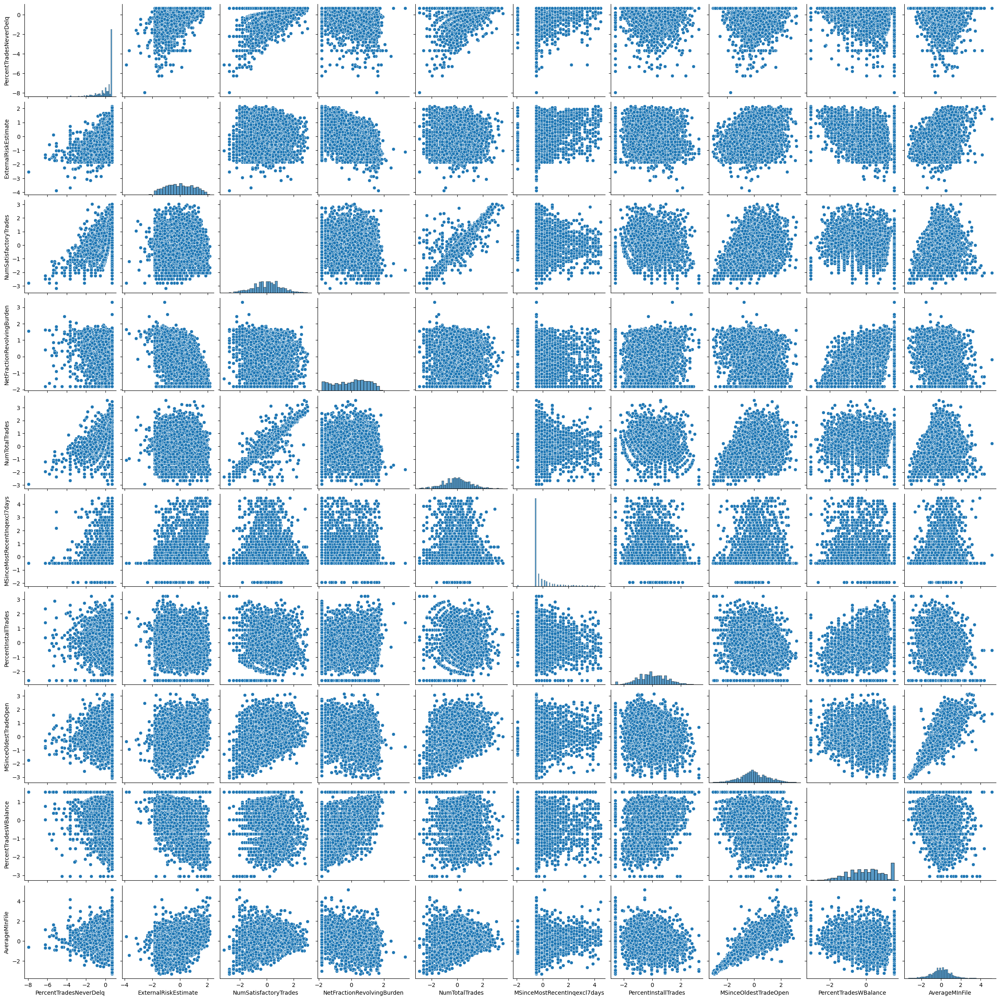

In [41]:
sns.pairplot(train_transformed[inputs], diag_kind = "hist", kind = "scatter")

In [42]:
get_correlated_pairs(train_transformed[inputs])

{('PercentTradesNeverDelq', 'ExternalRiskEstimate'): 0.5324442437244029,
 ('ExternalRiskEstimate', 'NetFractionRevolvingBurden'): -0.6349122476181837,
 ('NumSatisfactoryTrades', 'NumTotalTrades'): 0.9231227438743767,
 ('NetFractionRevolvingBurden', 'PercentTradesWBalance'): 0.61542163971429,
 ('MSinceOldestTradeOpen', 'AverageMInFile'): 0.7899002964153045}